# 21M.387 Fundamentals of Music Processing
## Beat Detection 1

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd
from ipywidgets import interact

import sys
sys.path.append("../common")
from util import *
import fmp

%matplotlib inline
plt.rcParams['figure.figsize'] = (12, 3)

## Reading

Chapter 6.0 - 6.1.2 (pp 303 – 312)

<img src="images/book_cover.png" width=200>

## Where's the beat?

- Definition of Beat: 
  - Sequence of perceived pulses that are equally spaced in time. 
  - Where a person would typically tap their foot.
- Can be fairly obvious for some songs with strong, repetitive pulses: rock / pop, etc...
- Can be problematic (even for humans) for other types of music:
  - very weak onsets
  - no clear / steady metric pulse
  - no clear rhythm (ambient)
  - overly complex rhythm

Some Examples:

Strong, Steady Beat

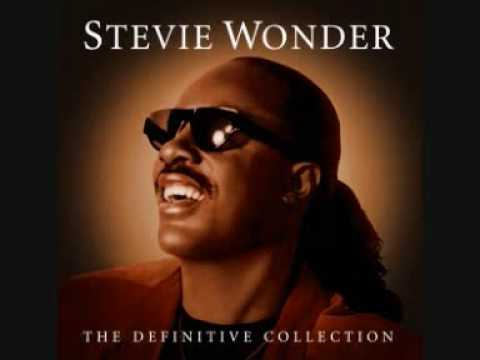

In [2]:
ipd.YouTubeVideo("0CFuCYNx-1g")

Beat is prominent, but potentially ambiguous rate (double time? half time?)

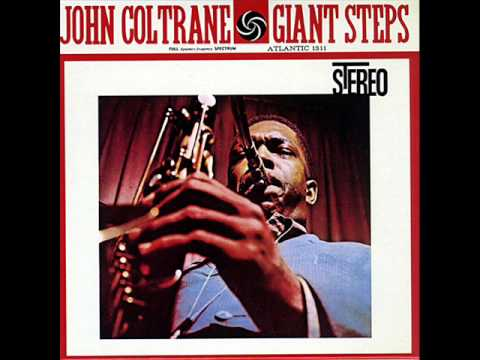

In [3]:
ipd.YouTubeVideo("xr0Tfng9SP0")

Vocal music - weak onsets

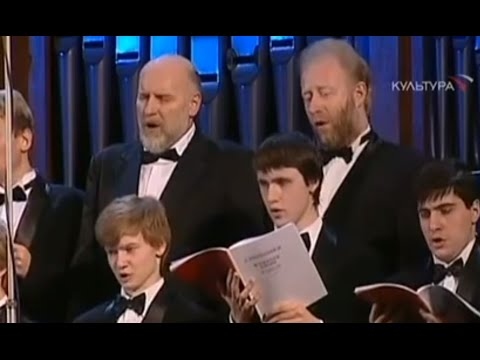

In [4]:
ipd.YouTubeVideo("d-cG0N94LPw", start=433)

Ambient Music

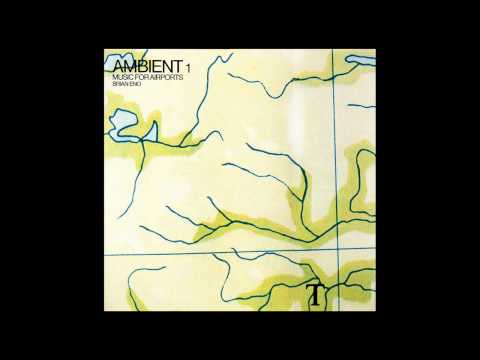

In [5]:
ipd.YouTubeVideo("ZWUlLHv7-64")

Complex / non-steady

In [6]:
ipd.YouTubeVideo("M6_OBBaIUvo")

## Pulse Definitions
- _Tactus_: The beat
- _Measure_: Higher level beat
- _Tatum_:  Lower level (temporal atom)

<img src="images/metric_levels.png">

## Basic Strategy

<img src="images/beat_tracking_overview.png">

## Onset Detection

- Where a note starts
- Typically characterized by a change in energy, pitch, or timbre.

<img src="images/onset.png" width=600>

### Energy-Based Novelty

Remember from the Zero-Crossing Lecture. The steps are:
- Begin with a time-domain signal
- Apply windowing
- Calculate per-window average energy
- Differentiate
- Half-Wave Rectify (keep only positive signal)

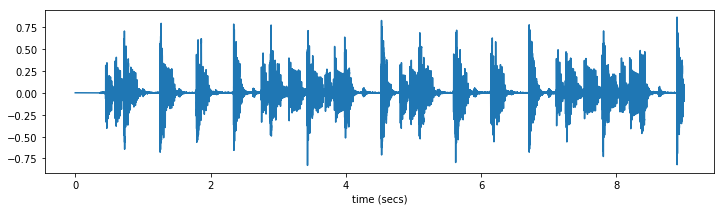

In [7]:
plot_and_listen("audio/queen_another_one.wav", 9)

- Window the signal with parameters $N = 1000, H=500$.
- Calculate per-window average energy to create the _Energy Countour_

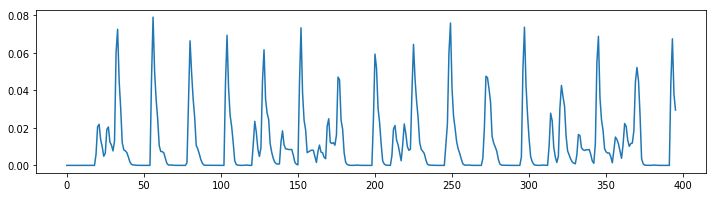

In [8]:
snd = load_wav("audio/queen_another_one.wav", 0, 9)
fs = 22050

win_len = 1000
hop_size = 500
x_e = fmp.calc_energy(snd, win_len, hop_size)
plt.plot(x_e);

Differentiate

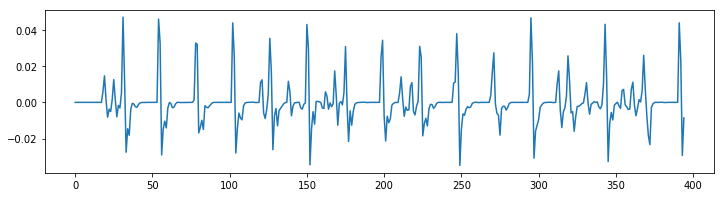

In [9]:
de = x_e[1:] - x_e[:-1]
plt.plot(de);

Half-wave rectify

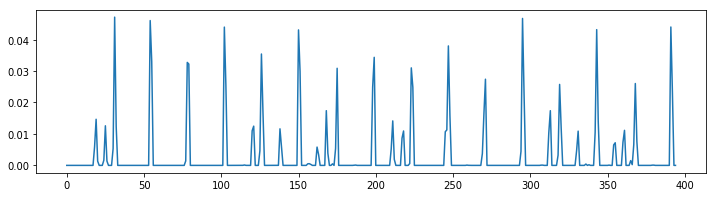

In [10]:
de[ de < 0 ] = 0
plt.plot(de);

The above plot is known as the Energy Novelty Function: $\Delta(n)$.

Pick Peaks

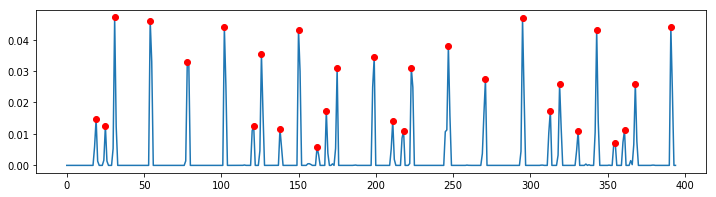

In [11]:
peaks = find_peaks(de, 0.05)
plt.plot(de)
plt.plot(peaks, de[peaks], 'ro');

Listen to Results

In [12]:
click_snd = load_wav("audio/click.wav")
clicks = fmp.make_clicks(peaks * hop_size, len(snd), click_snd)
ipd.Audio([snd * 0.4, clicks], rate=fs)

Combine this whole process in one function:

In [13]:
def energy_onset_peaks(filepath) :
    fs = 22050
    win_len = 1000
    hop_size = 500

    snd = load_wav(filepath)[:fs * 10]
    x_e = fmp.calc_energy(snd, win_len, hop_size)
    de = x_e[1:] - x_e[:-1]
    de[ de < 0 ] = 0
    peaks = find_peaks(de, 0.05)

    plt.figure()
    plt.plot(snd)
    plt.figure()
    plt.plot(de)
    plt.plot(peaks, de[peaks], 'ro');

    click_snd = load_wav("audio/click.wav")
    clicks = fmp.make_clicks(peaks * hop_size, len(snd), click_snd)
    return ipd.Audio([snd * 0.2, clicks], rate=fs + 1)


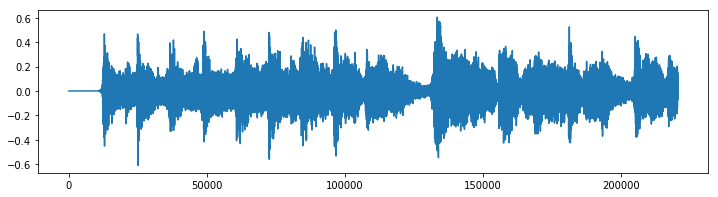

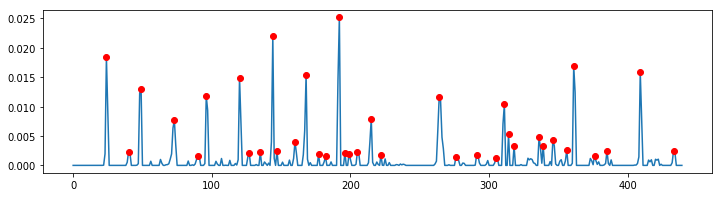

In [14]:
energy_onset_peaks("audio/beatles_being_for_the_benefit_of_mr_kite.wav")

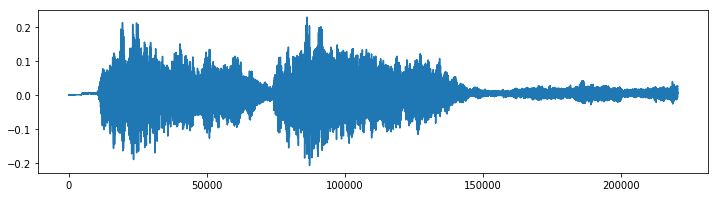

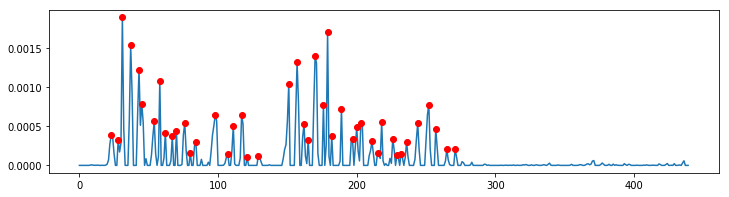

In [15]:
energy_onset_peaks("audio/beeth5_orch_21bars.wav")

This clearly doesn't work very well. We need a better technique.

### Spectral-Based Novelty

Create the spectrogram of the signal: $\lvert \mathcal{X(n,k)} \lvert^2$

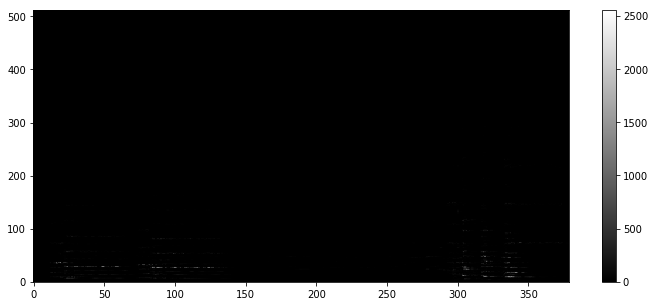

In [16]:
plt.rcParams['figure.figsize'] = (12, 5)

snd = load_wav("audio/beeth5_orch_21bars.wav")
fs = 22050
win_len = 2048
hop_size = win_len / 2
spec = fmp.stft_mag(snd, win_len, hop_size) ** 2

plt.imshow(spec, origin='lower', aspect='auto', cmap="gray")
plt.ylim(0, win_len/4)
plt.colorbar();

Apply Log Compression

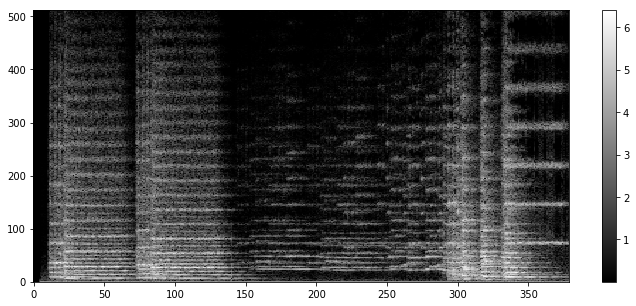

In [17]:
gamma = 1000
log_spec = np.log10(1 + gamma * spec)
plt.imshow(log_spec, origin='lower', aspect='auto', cmap="gray") 
plt.ylim(0, win_len/4)
plt.colorbar();

Frame-wise differentiation and half-wave rectification

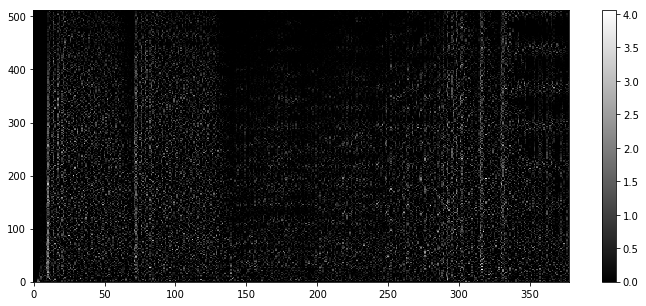

In [18]:
dls = log_spec[:, 1:] - log_spec[:, :-1]
dls[dls < 0] = 0
plt.imshow(dls, origin='lower', aspect='auto', cmap="gray") 
plt.ylim(0, win_len/4)
plt.colorbar();

Accumulate along all columns

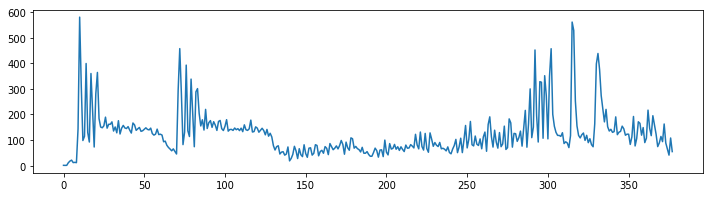

In [19]:
plt.rcParams['figure.figsize'] = (12, 3)
spec_nov = np.sum(dls, axis = 0)
plt.plot(spec_nov);

Improve curve by subtracting local average

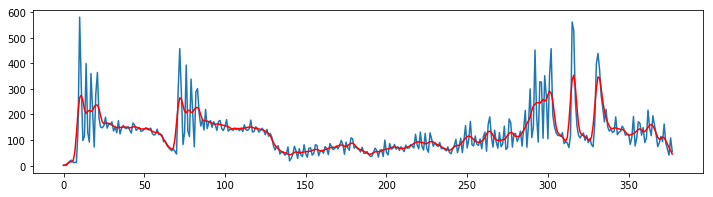

In [20]:
ave_len = 9
win = np.hanning(ave_len) / np.sum(np.hanning(ave_len))
la = np.convolve(spec_nov, win, mode='same') * 1.02

plt.plot(spec_nov)
plt.plot(la, 'r');

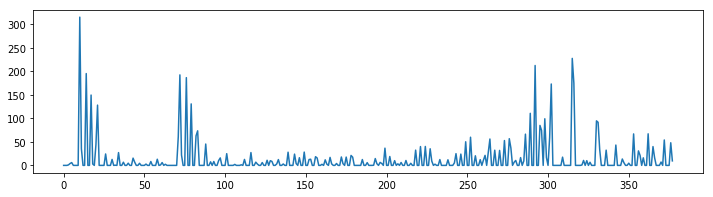

In [21]:
spec_nov2 = spec_nov - la
spec_nov2[spec_nov2 < 0] = 0
plt.plot(spec_nov2);

The function above is spectral novelty function, which we also call $\Delta(n)$.

Or perhaps $\Delta^s(n)$ to distinguish it from $\Delta^e(n)$, the energy-based novelty function.

From this, we can pick peaks, and listen to the result:

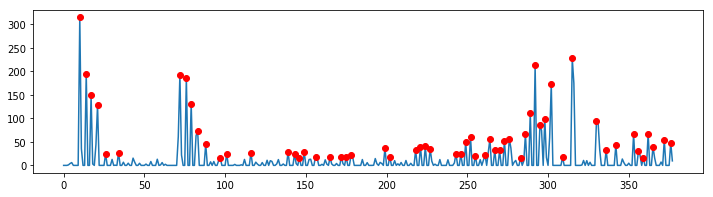

In [22]:
peaks = find_peaks(spec_nov2, 0.05)
plt.plot(spec_nov2);
plt.plot(peaks, spec_nov2[peaks], 'ro');

In [23]:
clicks = fmp.make_clicks(peaks * hop_size, len(snd), click_snd)
ipd.Audio([snd * 0.4, clicks], rate=fs)

Let's play with the parameters $N$ and $\gamma$

In [27]:
def spectral_onset_peaks(snd, win_len, gamma, listen=False):
    fs = 22050
    hop_size = win_len / 2

    nov = fmp.spectral_novelty(snd, win_len, hop_size, gamma)    
    peaks = find_peaks(nov, 0.05)

    plt.plot(nov);
    plt.plot(peaks, nov[peaks], 'ro');
    txt = '$N=%d, H=%d$\n$\gamma=%d$' % (win_len, hop_size, gamma)
    plt.text(0.01, 1.1, txt, fontsize=15, transform=plt.axes().transAxes)
    
    if listen:
        clicks = fmp.make_clicks(peaks * hop_size, len(snd), load_wav("audio/click.wav"))
        return ipd.Audio([snd * 0.2, clicks], rate=fs)        
        
@interact(win_i = (0, 3), g_i= (0, 4))
def test_spectral_onset_peaks(win_i, g_i):
    win_len = [512, 1024, 2048, 4096][win_i]
    gamma = [.1, 1,10,100,1000][g_i]
    spectral_onset_peaks(snd, win_len, gamma)
    plt.show()

interactive(children=(IntSlider(value=1, description=u'win_i', max=3), IntSlider(value=2, description=u'g_i', max=4), Output()), _dom_classes=('widget-interact',))

Back to the Queen example: Note how the high-hat is now captured much better.

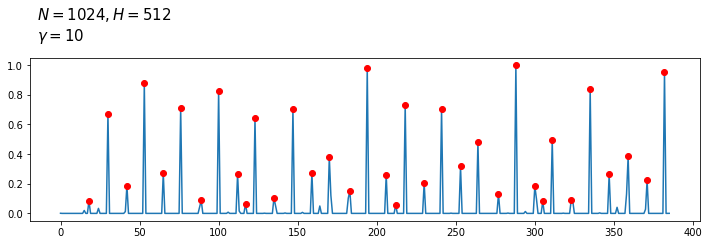

In [28]:
win_len = 1024
gamma = 10
spectral_onset_peaks(load_wav("audio/queen_another_one.wav", 0, 9), win_len, gamma, True)

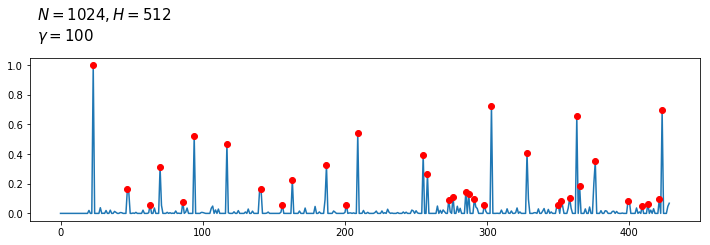

In [29]:
win_len = 1024
gamma = 100
spectral_onset_peaks(load_wav("audio/beatles_being_for_the_benefit_of_mr_kite.wav", 0, 10), win_len, gamma, True)

## Tempo Analysis

Peak picking can be problematic / tweaky.

In the following approach, we analyze the spectral novelty signal in a different way.

The goal is to create a _tempogram_: a mid-level feature representation that illuminates information about the tempo of an audio recording.


### Fourier Tempogram

The idea is to create a Short Term Fourier Transform (STFT) of $\Delta(n)$ which we will call $\mathcal{F}(n,k)$.

Load the audio example:

In [30]:
snd = load_wav("audio/beatles_i_want_you.wav", 0, 60)
fs = 22050

ipd.Audio(snd, rate = fs)

As above, create $\Delta(n)$, the spectral novelty curve:

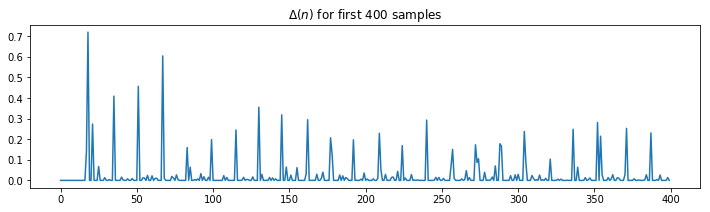

In [31]:
win_len = 1024
hop_size = win_len/2
nov = fmp.spectral_novelty(snd, win_len, hop_size, 100)
plt.plot(nov[0:400])
plt.title("$\Delta(n)$ for first 400 samples");

Note that for this choice of parameters, the feature rate of $\Delta(n)$ is $F_f = {F_s \over H}$.

In [32]:
ff = fs / float(hop_size) # feature rate of novelty curve
print "feature rate: %.2fHz. Period = %.2f ms" % (ff, 1000 / ff)

feature rate: 43.07Hz. Period = 23.22 ms


Now, compute the STFT of $\Delta(n)$ using these parameters:

$N_{tg} = 256$  
$H_{tg} = 8$

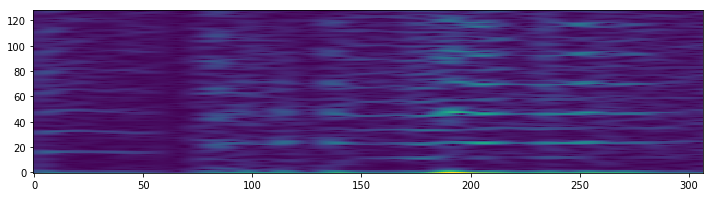

In [33]:
win_len_tg = 256
hop_tg = 8
tg = fmp.stft(nov, win_len_tg, hop_tg)

plt.imshow(abs(tg), origin='lower', aspect='auto');

This is the tempogram indexed by $(n,k)$. How do we interpret this?

On the time-axis the feature rate is: 
$$F_{tg} = {F_f \over H_{tg}}\text{Hz}$$

Or, the time resolution is 
$$T_{tg} = {H_{tg} \over F_f }\text{seconds}$$


In [34]:
f_tg = ff / hop_tg
print 'time resolution = %.2f Hz or %.2f seconds' % (f_tg, 1/f_tg)

time resolution = 5.38 Hz or 0.19 seconds


So the time (in seconds) at each horizontal index value is:

$$t = n \cdot {H_{tg} \over F_f }\text{seconds}$$

One the frequency axis, the _frequency resolution_ is:
$$ {F_f \over N_{tg}} $$

In [35]:
freq_res_tg = ff / win_len_tg
print 'frequency resolution = %.3f Hz' % freq_res_tg

frequency resolution = 0.168 Hz


So each bin ($k$) corresponds to the frequency:
$$ f_k = k \cdot {F_f \over N_{tg} }$$

The units of $f$ are cycles (beats) per second. Therefore to get BPM (beats per minute):

$$ \tau_k = k \cdot 60 \cdot {F_f \over N_{tg} }$$

In [36]:
tg_bpms = 60 * np.arange(tg.shape[0]) * freq_res_tg

print 'bpms:'
print tg_bpms

bpms:
[    0.            10.09368896    20.18737793    30.28106689    40.37475586
    50.46844482    60.56213379    70.65582275    80.74951172    90.84320068
   100.93688965   111.03057861   121.12426758   131.21795654   141.31164551
   151.40533447   161.49902344   171.5927124    181.68640137   191.78009033
   201.8737793    211.96746826   222.06115723   232.15484619   242.24853516
   252.34222412   262.43591309   272.52960205   282.62329102   292.71697998
   302.81066895   312.90435791   322.99804688   333.09173584   343.1854248
   353.27911377   363.37280273   373.4664917    383.56018066   393.65386963
   403.74755859   413.84124756   423.93493652   434.02862549   444.12231445
   454.21600342   464.30969238   474.40338135   484.49707031   494.59075928
   504.68444824   514.77813721   524.87182617   534.96551514   545.0592041
   555.15289307   565.24658203   575.340271     585.43395996   595.52764893
   605.62133789   615.71502686   625.80871582   635.90240479   645.99609375
   656.0

Let's have a closer look at the columns of the tempogram:

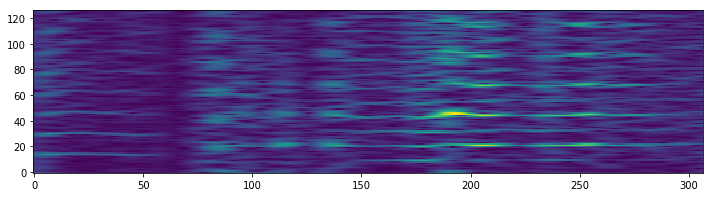

In [37]:
plt.imshow(abs(tg[2:,:]), origin='lower', aspect='auto');

Here we are looking at one column at a time.

In [38]:
@interact(n=(0,tg.shape[1]-1), _bpm=False)
def tg_scan(n = 0, _bpm = False):
    if _bpm:
        plt.plot(tg_bpms, abs(tg[:,n]))
        plt.xlabel('BPM')        
    else:
        plt.plot(abs(tg[:,n]))
        plt.xlabel('k')
    plt.show()

interactive(children=(IntSlider(value=0, description=u'n', max=306), Checkbox(value=False, description=u'_bpm'), Output()), _dom_classes=('widget-interact',))

This gives us a pretty good view of the general tempo characteristics of the song. But, we want something more accurate. We only have a resolution of about 10 BPM.

Let's use the zero-padding trick to get a finer sampling resolution of the frequency domain for the Fourier Transform:

Currently, the FT window is length $N_{tg}=256$. Let's zero-pad by a factor of $Z_{tg} = 16$, giving a frequency resolution of:

$$ 60 \cdot {F_f \over N_{tg} \cdot Z_{tg} }$$


In [74]:
win_len_tg = 256
hop_tg = 8
zp_tg = 16
freq_res_tg = ff / (win_len_tg * zp_tg)
print "enhanced frequency resolution = %.2f BPM" % (60 * freq_res_tg)


enhanced frequency resolution = 0.63 BPM


Here are the BPM values with the enahanced tempo resolution

In [75]:
tg_bpms = 60 * np.arange(win_len_tg * zp_tg /2 + 1) * freq_res_tg
print tg_bpms.shape
print tg_bpms[0:40]
print '...'
print tg_bpms[300:340]

(2049,)
[  0.           0.63085556   1.26171112   1.89256668   2.52342224
   3.1542778    3.78513336   4.41598892   5.04684448   5.67770004
   6.3085556    6.93941116   7.57026672   8.20112228   8.83197784
   9.4628334   10.09368896  10.72454453  11.35540009  11.98625565
  12.61711121  13.24796677  13.87882233  14.50967789  15.14053345
  15.77138901  16.40224457  17.03310013  17.66395569  18.29481125
  18.92566681  19.55652237  20.18737793  20.81823349  21.44908905
  22.07994461  22.71080017  23.34165573  23.97251129  24.60336685]
...
[ 189.25666809  189.88752365  190.51837921  191.14923477  191.78009033
  192.41094589  193.04180145  193.67265701  194.30351257  194.93436813
  195.56522369  196.19607925  196.82693481  197.45779037  198.08864594
  198.7195015   199.35035706  199.98121262  200.61206818  201.24292374
  201.8737793   202.50463486  203.13549042  203.76634598  204.39720154
  205.0280571   205.65891266  206.28976822  206.92062378  207.55147934
  208.1823349   208.81319046  209

Finally, the enhanced tempogram. The function `fmp.stft()` has an optional argument that allows for a zero-padding factor.

Note the number of bins (ie, # of rows) is much higher.

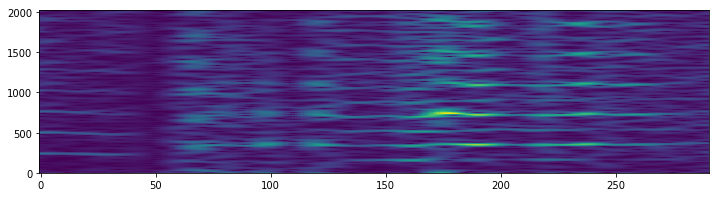

In [76]:
tg = fmp.stft(nov, win_len_tg, hop_tg, zp_tg, centered=False)
plt.imshow(abs(tg[20:,:]), origin='lower', aspect='auto');

Listen to the implied tempo

[ 160.86816788  321.73633575  482.60450363  644.73438263  806.86426163
  968.36328506]


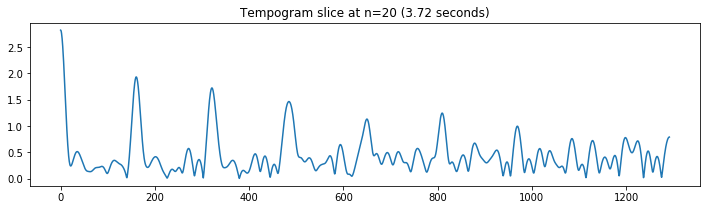

In [85]:
location = 20
# location = 165
plt.plot(tg_bpms, abs(tg[:,location]))
plt.title('Tempogram slice at n=%d (%.2f seconds)' % (location, location / f_tg ))
peak_bpms = tg_bpms[find_peaks(tg[:,location], 0.5)]
print peak_bpms

In [86]:
click_snd = load_wav("audio/click.wav")

@interact(peak=(0,3))
def test_beats(peak=0):
    print 'BPM:', peak_bpms[peak]
    beats = np.arange(10) * int(60 * fs  / peak_bpms[peak])
    clicks = fmp.make_clicks(beats, click_snd = click_snd)
    return ipd.Audio(clicks, rate=fs)

interactive(children=(IntSlider(value=0, description=u'peak', max=3), Output()), _dom_classes=('widget-interact',))

In [84]:
ipd.Audio(snd, rate = fs)

### Autocorrelation Tempogram

Another approach to create a tempogram is to use autocorrelation.

As before, this is the novelty function: $\Delta(n)$

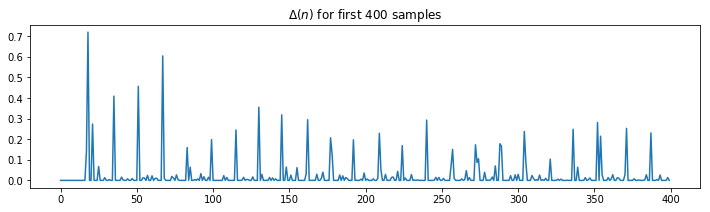

In [89]:
snd = load_wav("audio/beatles_i_want_you.wav", 0, 60)
fs = 22050
win_len = 1024
hop_size = win_len/2
nov = fmp.spectral_novelty(snd, win_len, hop_size, 100)
ff = fs / float(hop_size) # feature rate of novelty curve

plt.figure()
plt.plot(nov[0:400])
plt.title("$\Delta(n)$ for first 400 samples");

In autocorrelation, we take a window of a signal and shift it against itself, taking the dot product at each step.

The step number is also know as the _lag_.

For example, start with a window of $L=100$

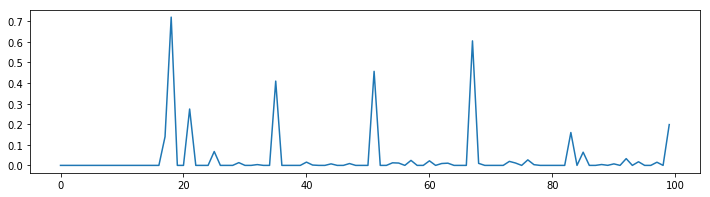

In [88]:
wx = nov[0:100]
plt.plot(wx);

Now, for this window of data $x(n)$, perform shifted dot products:

$$ R_{xx}(l) = \sum_{n=0}^{L-1} x(n) x(n-l) $$


In [90]:
@interact(lag=(0, 99))
def test_ac(lag = 0) :
    L = len(wx)
    a = wx
    b = np.concatenate((np.zeros(lag), wx[0:L-lag]))
    dp = a.dot(b)
    plt.plot(a);
    plt.plot(b, 'r');
    txt = '$R_{xx}(%d) = %.2f$' % (lag, dp)
    plt.text(0, .9, txt, fontsize=20)
    plt.show()

interactive(children=(IntSlider(value=0, description=u'lag', max=99), Output()), _dom_classes=('widget-interact',))

The function `auto_correlate()` below generates the autocorrelation based on the numpy function `np.correlate`

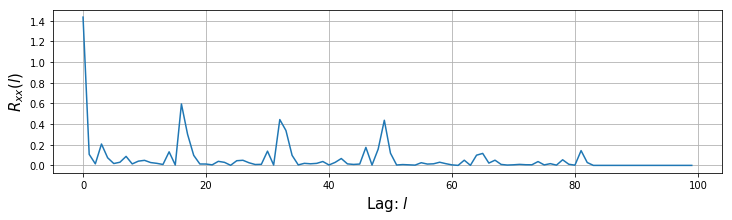

In [93]:
def auto_correlate(x):
    ac = np.correlate(x, x, mode='full')
    return ac[len(x)-1:]

ac = auto_correlate(wx);
plt.plot(ac);
plt.grid(True)
plt.xlabel('Lag: $l$', fontsize=15)
plt.ylabel('$R_{xx}(l)$', fontsize=15);

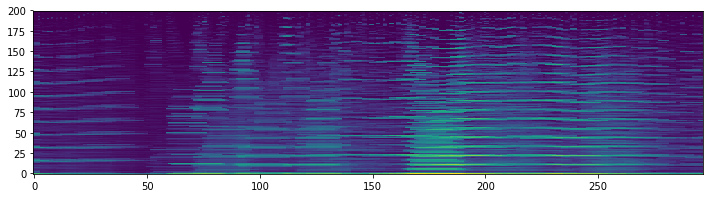

In [94]:
win_len_tg = 200
hop_tg = 8

tg = fmp.make_ac_tempogram(nov, win_len_tg, hop_tg)

plt.figure()
plt.imshow(np.log10(.1+tg), origin='lower', aspect='auto');

This is the autocorrelation tempogram: $\mathcal{A}(n,l)$

- $n$ is "time" - horizontal
- $l$ is "lag" - vertical.


The time-axis is the same as the STFT tempogram: 
$$t = n / F_{tg}$$

But on the vertical axis, each bin ($l$) corresponds to a lag value. This is _time_, not _frequency_. The periodicity of each bin (in seconds) is:
$$ T_l = {l \over F_f} $$

In [97]:
periods = np.arange(win_len_tg) / ff
print 'periods (in seconds) ='
print periods[0:20]
print '...'
print periods[180:200]

periods (in seconds) =
[ 0.          0.02321995  0.04643991  0.06965986  0.09287982  0.11609977
  0.13931973  0.16253968  0.18575964  0.20897959  0.23219955  0.2554195
  0.27863946  0.30185941  0.32507937  0.34829932  0.37151927  0.39473923
  0.41795918  0.44117914]
...
[ 4.17959184  4.20281179  4.22603175  4.2492517   4.27247166  4.29569161
  4.31891156  4.34213152  4.36535147  4.38857143  4.41179138  4.43501134
  4.45823129  4.48145125  4.5046712   4.52789116  4.55111111  4.57433107
  4.59755102  4.62077098]


The frequency at each bin is the inverse:
$$ f_l = {F_f \over l }$$

And the BPM (beats per minute) at each bin $l$ is:

$$ \tau_l =  60 \cdot {F_f \over l } $$

In [99]:
tg_bpms = 60 * ff / np.arange(win_len_tg)
print 'bpms ='
print tg_bpms[0:20]
print '...'
print tg_bpms[80:120]

bpms =
[           inf  2583.984375    1291.9921875    861.328125     645.99609375
   516.796875     430.6640625    369.140625     322.99804688   287.109375
   258.3984375    234.90767045   215.33203125   198.76802885   184.5703125
   172.265625     161.49902344   151.99908088   143.5546875    135.99917763]
...
[ 32.29980469  31.90104167  31.51200457  31.13234187  30.76171875
  30.39981618  30.04632994  29.70096983  29.36345881  29.0335323
  28.7109375   28.39543269  28.08678668  27.78477823  27.48919548
  27.19983553  26.91650391  26.63901418  26.3671875   26.10085227
  25.83984375  25.58400371  25.33318015  25.08722694  24.84600361
  24.609375    24.37721108  24.14938668  23.92578125  23.70627867
  23.49076705  23.27913851  23.07128906  22.86711836  22.66652961
  22.46942935  22.27572737  22.08533654  21.89817267  21.71415441]


/home/scottviteri/Dropbox/MyBrain/BodySelf/FormalEducation/MIT/Year4/Fall/21M.387/DevEnv/lib/python2.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in divide
  """Entry point for launching an IPython kernel.


This tempogram has a non-uniform frequency resolution. The frequency resolution gets better as the tempo values get slower.

In [100]:
@interact(n=(0,200), _bpm=False)
def tg_plot(n=0, _bpm=False):
    if _bpm:
        plt.plot(tg_bpms, tg[:, n])
        plt.xlim(20, 200)
        plt.xlabel('BPM')
    else:
        plt.plot(tg[:, n])
        plt.xlabel('Lag')
    plt.ylim(0, 1)
    plt.show()

interactive(children=(IntSlider(value=0, description=u'n', max=200), Checkbox(value=False, description=u'_bpm'), Output()), _dom_classes=('widget-interact',))

Listen to the implied tempo:

[ 161.49902344   80.74951172   53.83300781   40.37475586   32.29980469
   27.19983553   23.07128906]


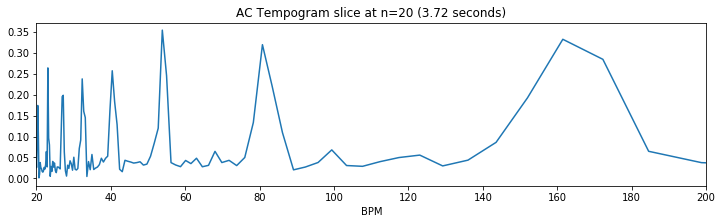

In [101]:
location = 20
# location = 165
plt.plot(tg_bpms, tg[:, location])
plt.xlim(20, 200)
plt.xlabel('BPM')
plt.title('AC Tempogram slice at n=%d (%.2f seconds)' % (location, location / f_tg ))

peak_bpms = tg_bpms[find_peaks(tg[:,location], 0.5)]
print peak_bpms

In [103]:
@interact(peak=(0,3))
def test_beats(peak=0):
    print 'BPM:', peak_bpms[peak]
    beats = np.arange(10) * int(60 * fs  / peak_bpms[peak])
    clicks = fmp.make_clicks(beats, click_snd = click_snd)
    return ipd.Audio(clicks, rate=fs)

interactive(children=(IntSlider(value=0, description=u'peak', max=3), Output()), _dom_classes=('widget-interact',))

In [105]:
ipd.Audio(snd, rate = fs)

Both tempograms are intersting and highlight different rhytmic attributes of the song:

- Fourier Tempogram: highlight tempo harmonics (subdivisions of the beat)
- Autocorrelation Tempogram: highlights tempo subharmonics (groupings of beats)

### Predominant Local Pulse

We can use the information in a Tempogram to reconstruct the prominent pulses of some audio. The Fourier Tempogram is particularly useful because it also contains phase information.

The idea is to find the peak (maximum value) of the tempogram at each time step.

This is our Fourier Tempogram again, but this time with a larger hop size:  
$N_{tg} = 256$  
$H_{tg} = 64$  
$Z_{tg} = 16$  


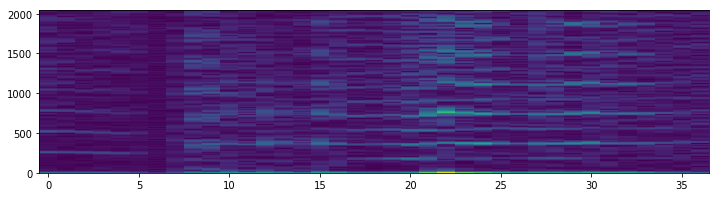

In [109]:
win_len_tg = 256
hop_tg = 64
zp_tg = 16

tg = fmp.stft(nov, win_len_tg, hop_tg, zp_tg, centered=False)
plt.imshow(abs(tg), origin='lower', aspect='auto');

Now, for each column, pick the maximum value to be the "most likely tempo" at that moment.

It is helpful to place limitations on the tempogram, so we don't bother with tempos that are too high or too low.

In [113]:
@interact(p = (0,tg.shape[1]-1), limit = False)
def tg_scan(p = 0, limit = False):
    tempo = abs(tg[:,p])
    col_max = np.max(tempo)
    if limit:
        tempo *= fmp.make_tempo_range_window(win_len_tg * zp_tg, ff, 40, 300)
        plt.title('Limit tempo to BPM range: 40 - 300')
    else:
        plt.title('Peak of Tempo Curve')        
    k = np.argmax(tempo)
    bpms = np.arange(len(tempo)) * 60 * ff/(win_len_tg * zp_tg)
    plt.plot(bpms, tempo)
    plt.plot(k, tempo[k], 'ro')
    plt.ylim(0, col_max)
    plt.show()
    

interactive(children=(IntSlider(value=0, description=u'p', max=36), Checkbox(value=False, description=u'limit'), Output()), _dom_classes=('widget-interact',))

Now, we apply this method (band-limited maxima) to capture the most likely tempo (tempogram bin) at each time step.

Here, as above, we constrain the tempogram to the BPM range of 40-300 BPM

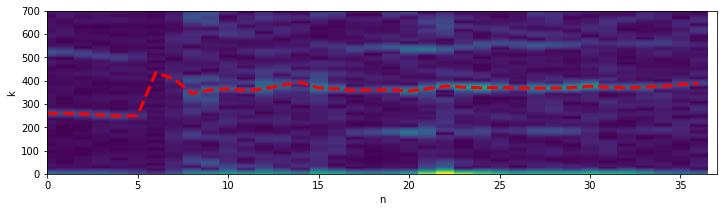

In [114]:
bins = fmp.best_tempogram_bins(tg, ff, 40, 300)
    
plt.imshow(abs(tg), origin='lower', aspect='auto')
plt.plot(np.arange(len(bins)), bins, 'r--', linewidth=3)
plt.xlim(0, tg.shape[1])
plt.ylim(0, 700)
plt.xlabel('n')
plt.ylabel('k');


The next step is to pick out the sinusoidal parameters from the tempogram. Since the tempogram is really a Spectrogram $\mathcal{F}(n,k)$, each point at $(n,k)$ is a complex number with a magnitude and a phase.

We can recreate the sinusoid associated with that point as follows:

With $c = \mathcal{F}(n,k)$:  
$A = {2 \over N}  \lvert c \lvert $  
$f = k \cdot {F_s \over N}$  
$\phi = \angle(c)$  

The sinusoid contributing to that part of the signal is:
$x(n) = A \cos(2 \pi f n / F_s + \phi)$


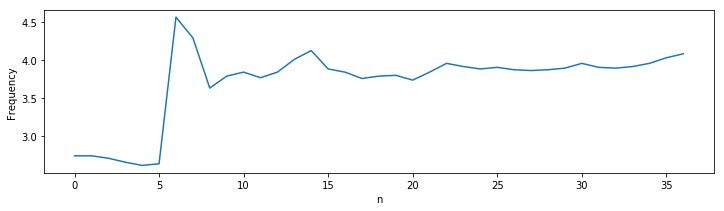

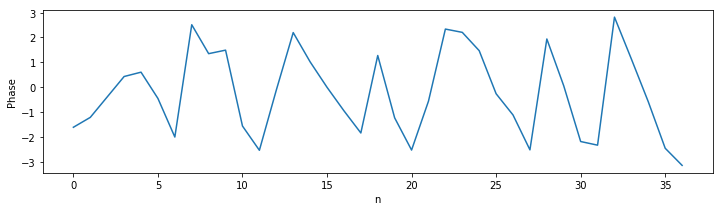

In [116]:
freqs, phases = fmp.get_sinusoid_params(tg, ff, bins)

plt.figure()
plt.plot(freqs)
plt.ylabel('Frequency')
plt.xlabel('n')
plt.figure()
plt.plot(phases)
plt.ylabel('Phase')
plt.xlabel('n');

A more useful way of viewing these frequencies and phases is to create sinusoids - which will form a "synthetic pulse train". 

Note that we ignore the amplitude of the sinusoid, and make them all uniform height.

It is also useful to window this pulse train with a Hann window.

In [118]:

@interact(h=(0,25), win=False)
def local_pulse_demo(h=0, win=False):
    start = h * hop_tg
    # print 'at h=%d: bin=%d, freq=%f, phase=%f' % (h, bins[h], freqs[h], phases[h])

    n = np.arange(win_len_tg)
    est = np.cos(2 * np.pi * freqs[h] * n / ff + phases[h])
    if win:
        est *= np.hanning(win_len_tg)
    est = np.concatenate((np.zeros(start), est))

    plt.title('Novelty Curve $\Delta(n)$ with synthesized pulse');
    plt.plot(nov * 3)
    plt.plot(est, 'r')
    plt.xlim(0,1000)
    plt.ylim(-1.5, 3)
    plt.show()

interactive(children=(IntSlider(value=0, description=u'h', max=25), Checkbox(value=False, description=u'win'), Output()), _dom_classes=('widget-interact',))

Now, combine all these windowed sinusoid pulses together:

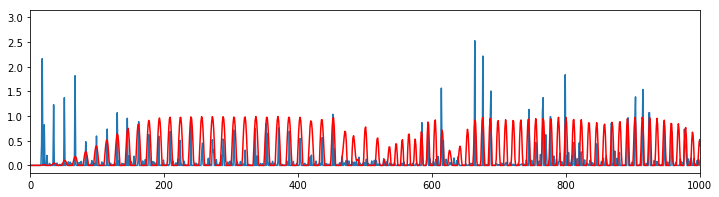

In [119]:
plp = fmp.make_local_pulse(nov, ff, 40, 300)
plt.plot(nov * 3)
plt.plot(plp, 'r')
plt.xlim(0,1000);

In [121]:
peaks = find_peaks(plp, thresh = 0)
beats = (peaks * (fs/ff)).astype(np.int)
clicks = fmp.make_clicks(beats, len(snd), load_wav('audio/click.wav'))
ipd.Audio([snd*.5, clicks],rate=fs)

Careful with Time Units!

- original sampling rate
- novelty function sampling rate
- tempogram sampling rate


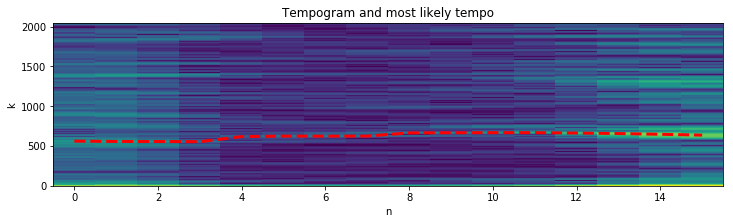

In [122]:
bpm_min = 60
bpm_max = 450

snd = load_wav("audio/beeth5_orch_21bars.wav")

fs = 22050
win_len = 1024
hop_size = win_len/2
nov = fmp.spectral_novelty(snd, win_len, hop_size, 100)
ff = float(fs)/hop_size

win_len_tg = 256
hop_tg = 32
zp_tg = 16
tg = abs(fmp.stft(nov, win_len_tg, hop_tg, zp_tg, centered=False))



bins = c
    
plt.imshow(np.log10(1 + tg), origin='lower', aspect='auto')
plt.plot(np.arange(len(bins)), bins, 'r--', linewidth=3)
plt.xlabel('n')
plt.ylabel('k')
plt.title('Tempogram and most likely tempo')

plp = fmp.make_local_pulse(nov, ff, bpm_min, bpm_max, win_len_tg, hop_tg, zp_tg)
peaks = find_peaks(plp, thresh = 0)
beats = (peaks * (fs/ff)).astype(np.int)
clicks = fmp.make_clicks(beats, len(snd), load_wav('audio/click.wav'))
ipd.Audio([snd, clicks * .5],rate=fs)
